In [ ]:
# Open and run scripts in Google Colab

!pip install osmnx
!pip install contextily

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 101.5/101.5 kB 1.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.3/22.3 MB 32.4 MB/s eta 0:00:00


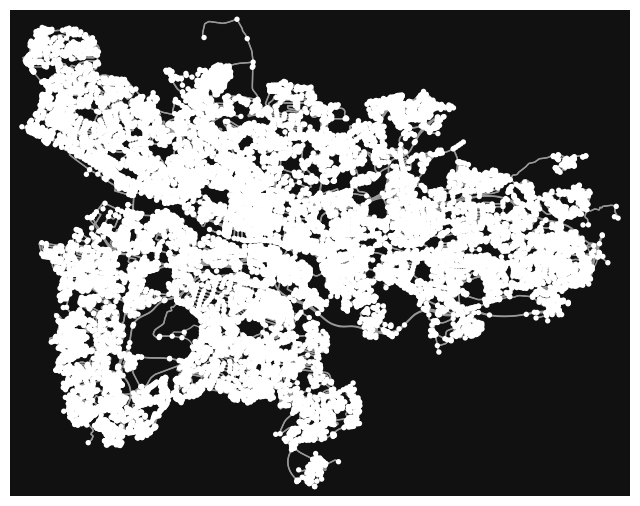

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [2]:
import osmnx as ox
import networkx as nx
import geopandas as gpd
from shapely.geometry import Polygon

# Define the places to get the road network from
places = ["Glasgow City, Scotland, United Kingdom"]

# Get the road network for the specified places
G = ox.graph_from_place(places, network_type="drive")

# List of coordinates
coords = [
    (-4.259002192127623, 55.84092088540592),
    (-4.248015864002623, 55.83667964452985),
    (-4.235656244861998, 55.83243794100018),
    (-4.221236689197935, 55.830124089517014),
    (-4.206817133533873, 55.828195774789755),
    (-4.193427546131529, 55.828002938059036),
    (-4.183471186268248, 55.83263075574337),
    (-4.162528498279967, 55.83282356953061),
    (-4.160468561756529, 55.83764360353537),
    (-4.180724604236998, 55.83822196746807),
    (-4.229476435291685, 55.83725802280082),
    (-4.248015864002623, 55.84246304011326),
    (-4.259002192127623, 55.84092088540592)
]

# Create a Polygon
polygon = Polygon(coords)

# Convert to a GeoDataFrame
motorwayconnect_gdf = gpd.GeoDataFrame([1], geometry=[polygon], crs="EPSG:4326")

coords = [
    (-4.3243661544739505,55.80018025874526),
    (-4.322220387262036,55.799939039098255),
    (-4.320160450738599,55.801482819016904),
    (-4.317585530084302,55.80452195686337),
    (-4.315783085626294,55.80703027288075),
    (-4.313208181776336,55.80835667467626),
    (-4.3114057205139895,55.810792443884736),
    (-4.309174195362446,55.812215214426296),
    (-4.310375752252271,55.812962761755614),
    (-4.319046060947753,55.80729534027722),
    (-4.3243661544739505,55.80018025874526)
]

# Create a Polygon
polygon = Polygon(coords)

# Convert to a GeoDataFrame
southconnect_gdf = gpd.GeoDataFrame([1], geometry=[polygon], crs="EPSG:4326")

# Get the road network for Glasgow plus the combined custom areas
G_city = ox.graph_from_place(["Glasgow City"], network_type="drive")
G_custom1 = ox.graph_from_polygon(motorwayconnect_gdf.geometry[0], network_type="drive")
G_custom2 = ox.graph_from_polygon(southconnect_gdf.geometry[0], network_type="drive")

# Merge both graphs
G = nx.compose(G_city, G_custom1)
G = nx.compose(G, G_custom2)

# Add edge speed/time attributes
G = ox.add_edge_speeds(G)
G = ox.add_edge_travel_times(G)

# Plot
ox.plot_graph(G)

In [3]:
import networkx as nx
import numpy as np
from scipy.sparse import csgraph
import matplotlib.pyplot as plt

structural_graph = nx.Graph(G)

# Extract metrics about the structural graph
num_nodes = structural_graph.number_of_nodes()

for u, v, data in structural_graph.edges(data=True):
  average_car_accelerating = np.sqrt((2*data['length'])/2)
  if data['travel_time'] < average_car_accelerating:
        data['travel_time'] = average_car_accelerating

  data['weight'] = (1 / (1 + data['travel_time']))

A = nx.adjacency_matrix(structural_graph)


/usr/local/lib/python3.12/dist-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib/python3.12/dist-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


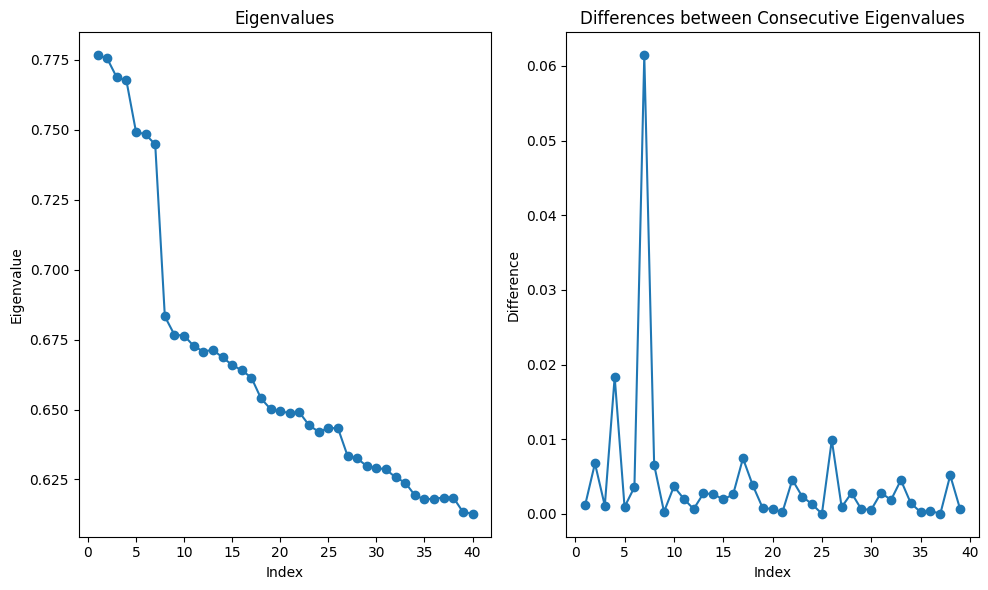

In [4]:
from scipy.sparse.linalg import eigs
import matplotlib.pyplot as plt

k_eigs=40

# Compute the eigenvalues and eigenvectors
eigenvalues, eigenvectors = eigs(A, k=k_eigs, which='LR')

# Replace complex conjugate eigenvectors with magnitudes of real and imaginary components
for i in range(k_eigs):
    if np.iscomplex(eigenvectors[:, i]).any():
        eigenvectors[:, i] = np.abs(eigenvectors[:, i].real)
        if i + 1 < k_eigs and np.iscomplex(eigenvectors[:, i + 1]).any():
            eigenvectors[:, i + 1] = np.abs(eigenvectors[:, i + 1].imag)

# Plot eigenvalues
plt.figure(figsize=(10, 6))

# Subplot for eigenvalues
plt.subplot(1, 2, 1)
plt.plot(np.arange(1, k_eigs + 1), eigenvalues, marker='o', linestyle='-')
plt.title('Eigenvalues')
plt.xlabel('Index')
plt.ylabel('Eigenvalue')

# Calculate differences between consecutive eigenvalues
eigenvalue_diffs = abs(np.diff(eigenvalues))

# Subplot for differences between consecutive eigenvalues
plt.subplot(1, 2, 2)
plt.plot(np.arange(1, k_eigs), eigenvalue_diffs, marker='o', linestyle='-')
plt.title('Differences between Consecutive Eigenvalues')
plt.xlabel('Index')
plt.ylabel('Difference')

plt.tight_layout()
plt.show()

In [5]:
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize

# eigenvalues 1 to i, [1-1,i-1] where i = prominent eigengap
eig_selection = [0, 6]

### Local Eigenvector Centrality ###
# Calculate the norm of the vector for each node comprised of the selected eigenvectors
if eig_selection[1] > eig_selection[0]:
    dom_eigvecs = np.linalg.norm(eigenvectors[:, eig_selection[0]:eig_selection[1]+1], axis=1)
else:
    dom_eigvecs = eigenvectors[:, eig_selection[0]].reshape(-1, 1)

for it,node in enumerate(G.nodes):
    G.nodes[node]['local_centrality'] = dom_eigvecs[it]
    G.nodes[node]['local_centrality_pow'] = pow(dom_eigvecs[it],.2)
    G.nodes[node]['global_centrality'] = abs(eigenvectors[it, 0].real)

local_centrality = [G.nodes[node]['local_centrality'] for node in G.nodes]
local_pow_centrality = [G.nodes[node]['local_centrality_pow'] for node in G.nodes]
global_centrality = [G.nodes[node]['global_centrality'] for node in G.nodes]

In [6]:
# change map projection to Pseudo-Mercator
# this projection is used by most base map tile providers
G = ox.projection.project_graph(G, to_crs=3857)

# get edges as Geo data frame
gdf_nodes, gdf_edges = ox.graph_to_gdfs(G)

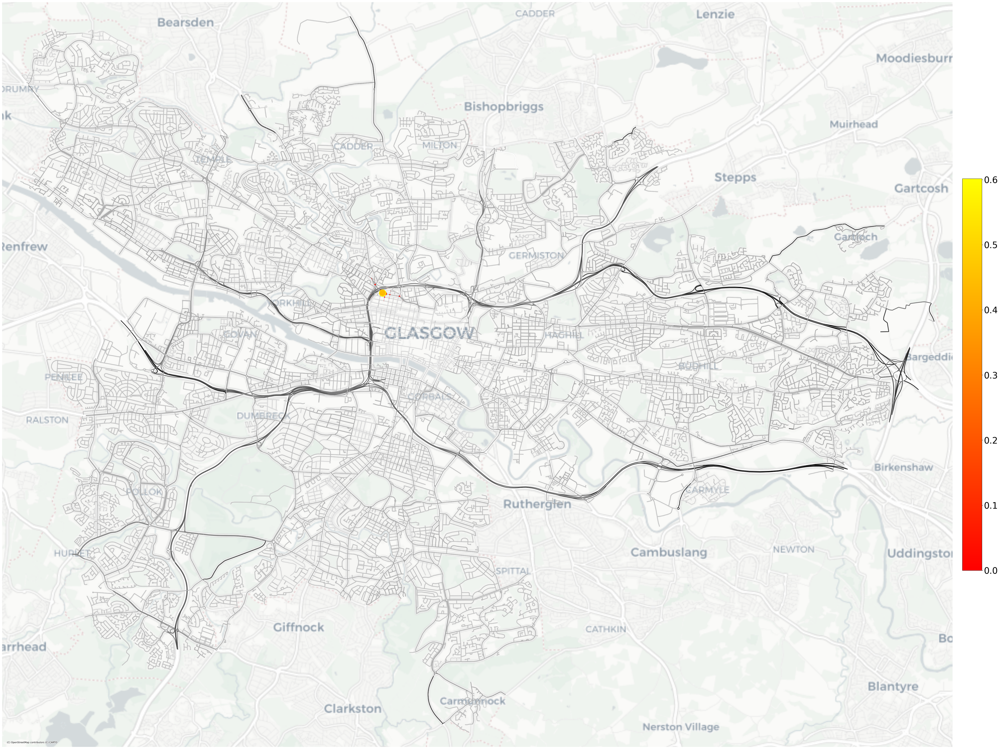

In [7]:
import contextily as ctx

# Define node sizes based on global centrality
node_sizes = [abs(G.nodes[node]['global_centrality']) * 1000 for node in G.nodes]

# Define edge colors based on speed limit
edge_colors = ox.plot.get_edge_colors_by_attr(G, attr='speed_kph', cmap='binary')

# Plot the graph with node colors based on global centrality and edge colors based on speed limit
fig, ax = ox.plot_graph(G, node_color=ox.plot.get_node_colors_by_attr(G, attr='global_centrality', cmap='autumn'),
                        node_size=node_sizes, edge_color=edge_colors, edge_linewidth=2,
                        figsize=(60, 60), show=False, close=False)

norm = Normalize(vmin=min(global_centrality), vmax=max(global_centrality))
sm = ScalarMappable(norm=norm, cmap='autumn')
sm.set_array([])

# Add colorbar
cbar = fig.colorbar(sm, ax=ax, fraction=0.02, pad=0.01)
cbar.ax.tick_params(labelsize=30)

# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

plt.show()

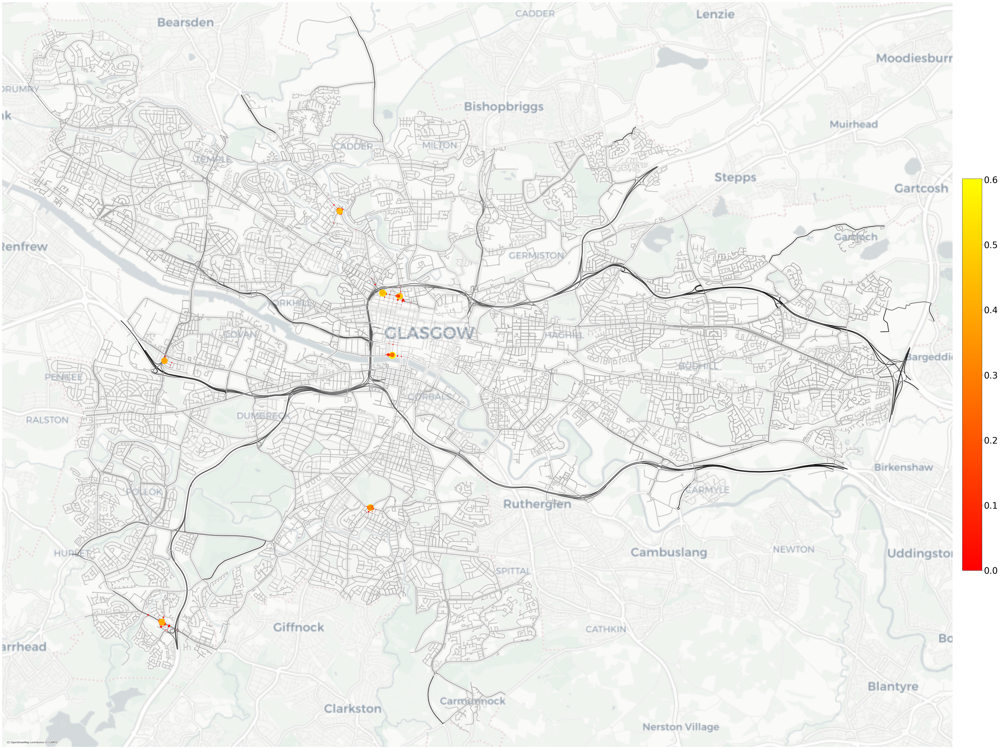

In [8]:
import contextily as ctx

node_sizes = [G.nodes[node]['local_centrality'] * 1000 for node in G.nodes]

# Define edge colors based on speed limit
edge_colors = ox.plot.get_edge_colors_by_attr(G, attr='speed_kph', cmap='binary')

# Plot the graph with node colors based on local centrality and edge colors based on speed limit
fig, ax = ox.plot_graph(G, node_color=ox.plot.get_node_colors_by_attr(G, attr='local_centrality', cmap='autumn'),
                        node_size=node_sizes, edge_color=edge_colors, edge_linewidth=2,
                        figsize=(60, 60), show=False, close=False)

norm = Normalize(vmin=min(local_centrality), vmax=max(local_centrality))
sm = ScalarMappable(norm=norm, cmap='autumn')
sm.set_array([])

# Add colorbar
cbar = fig.colorbar(sm, ax=ax, fraction=0.02, pad=0.01)
cbar.ax.tick_params(labelsize=30)

# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

plt.show()


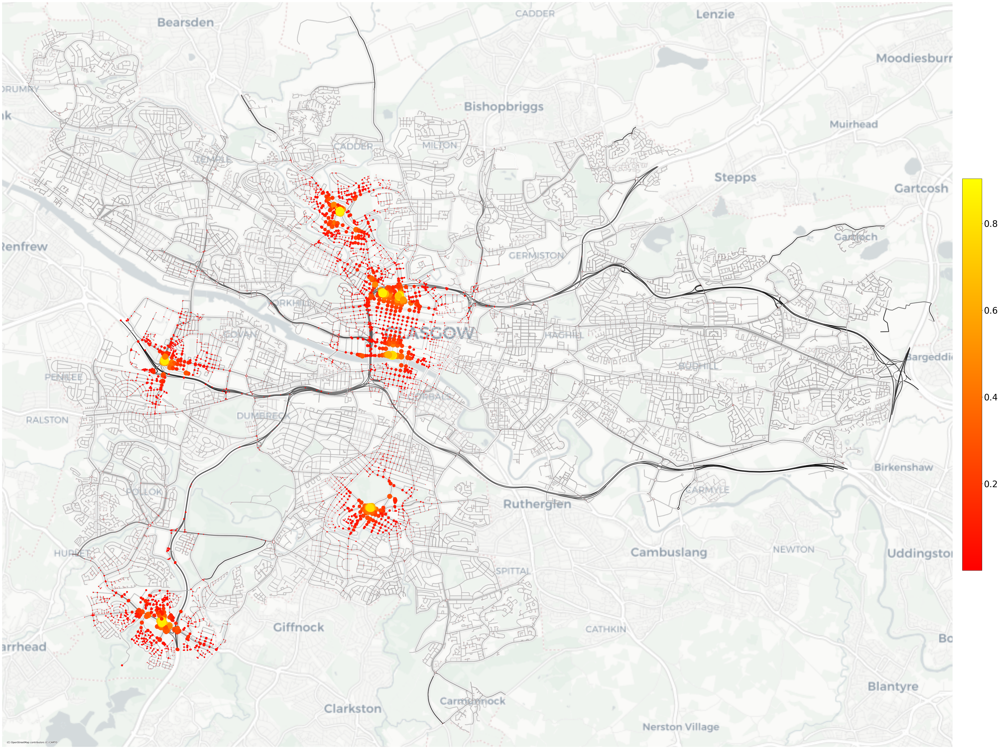

In [9]:
node_sizes = [G.nodes[node]['local_centrality_pow'] * 1000 for node in G.nodes]

# Define edge colors based on speed limit
edge_colors = ox.plot.get_edge_colors_by_attr(G, attr='speed_kph', cmap='binary')

# Plot the graph with node colors based on local centrality and edge colors based on speed limit
fig, ax = ox.plot_graph(G, node_color=ox.plot.get_node_colors_by_attr(G, attr='local_centrality_pow', cmap='autumn'),
                        node_size=node_sizes, edge_color=edge_colors, edge_linewidth=2,
                        figsize=(60, 60), show=False, close=False)

norm = Normalize(vmin=min(local_pow_centrality), vmax=max(local_pow_centrality))
sm = ScalarMappable(norm=norm, cmap='autumn')
sm.set_array([])

# Add colorbar
cbar = fig.colorbar(sm, ax=ax, fraction=0.02, pad=0.01)
cbar.ax.tick_params(labelsize=30)

# Add a basemap from OpenStreetMap
ctx.add_basemap(ax, source=ctx.providers.CartoDB.Positron)

plt.show()
